<h1 style= 'text-align: center;'> Tarea 3: Función ventana</h1>

<p style="text-align:center">
<img src="logo_uach-614a369aa9528.png"
width="600" height="600" alt="Tiny">

<p style='text-align: center;'><em>Integrantes: Aldo Henríquez </em></p>
<p style='text-align: center;'><em> Mauricio Martínez </em></p>
<p style='text-align: center;'><em>Profesor: Victor Poblete</em></p>
<p style='text-align: center;'><em>Ayudante: Esteban Vargas</em></p>

In [1]:
#Importamos todas las librerias que nos serán utiles para realizar el ventaneo de la señal, importar audios, etc
import numpy as np
import librosa as lib
from IPython.display import Audio
import matplotlib.pyplot as plt
from scipy import signal
from scipy.fft import fft,ifft,fftshift

In [2]:
#Importamos un audio y especificamos el sample rate
sig,fs=lib.load("AudioAmbiente.wav",sr=44100)
#La siguiente linea de codigo es para reproducir el Audio
Audio(sig, rate=fs)

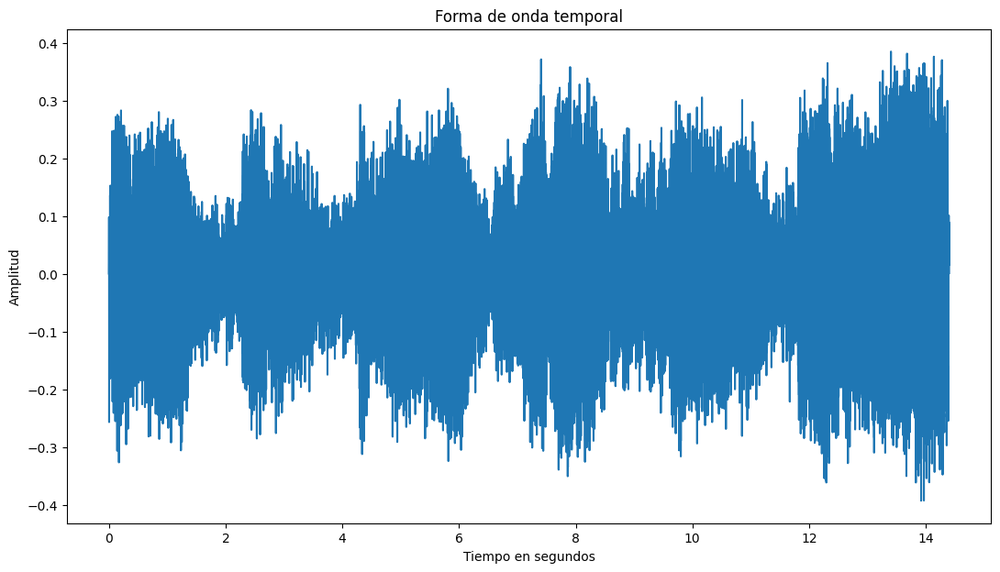

In [3]:
#Gráfica de la señal sig
t=np.linspace(0, len(sig)/fs,len(sig))

plt.figure(figsize=(13,7));
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Forma de onda temporal')
plt.plot(t,sig)


In [4]:
#Se especifica el overlap o el traslape de la señal y el largo de la ventana
len_f=1024
overlap=0.5

In [5]:
#Función que divide la señal en frames, dado un largo de ventana y su traslape
def ventanas(x,len_f,overlap):
    x=x.tolist()
    num_f=int(round(len(x)/(len_f-(len_f*overlap))))
    print(num_f)
    matriz_frames=[]
    for i in range(num_f):
        frame=x[i*round(len_f*overlap):i*round(len_f*overlap)+len_f]
        while len(frame)<len_f:
            frame.append(0)
        matriz_frames.append(frame)
    matf=np.array(matriz_frames)
    return matf

In [6]:
#En sig_frames tenemos la señal sig con la función ventanas aplicada para así dividir la señal en frames.
sig_frames=ventanas(sig,len_f,overlap)

1240


In [7]:
#(cantidad de ventanas,largo de la ventana)
sig_frames.shape

(1240, 1024)

In [8]:
#Largo de la ventana del frame 3
len(sig_frames[3])

1024

La linea de codigo anterior que nos da el largo del frame 3 nos sirve para corroborar que cada frame tiene el largo que se especifico en nuestra función ventanas.

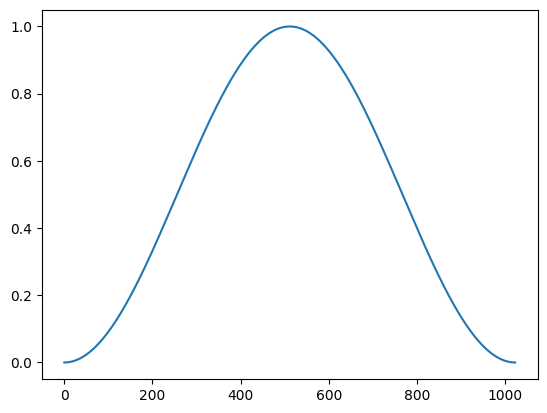

In [9]:
#Esta señal será la que nos dará el suavizado a cada uno de los frames
window = signal.windows.hann(1024)
plt.plot(window)

In [10]:
#Se le aplica el suavizado anterior a toda la matriz de frames
#Primero se crea una matriz vacía de la misma forma que sig_frames aqui iran los frames suavizados
smoothed_frames = np.empty_like(sig_frames)
#Luego se crea una iteración para suavizar cada frame de sig_frames
for i in range(sig_frames.shape[0]):
    smoothed_frames[i] = sig_frames[i] * window

In [11]:
#se crea una matriz donde están todos los frames suavizados con la transformada de fourier aplicada
fftframes = np.empty((smoothed_frames.shape[0], len_f), dtype=np.complex_)
for i in range(smoothed_frames.shape[0]):
    fftframes[i] = fft(smoothed_frames[i])

In [12]:
#Magnitud de la transformada para cada frames aplicada la transformada de fourier
magsig_fft = np.empty_like(fftframes, dtype=np.float_)
for i in range (fftframes.shape[0]):
    magsig_fft[i]=np.abs(fftframes[i])

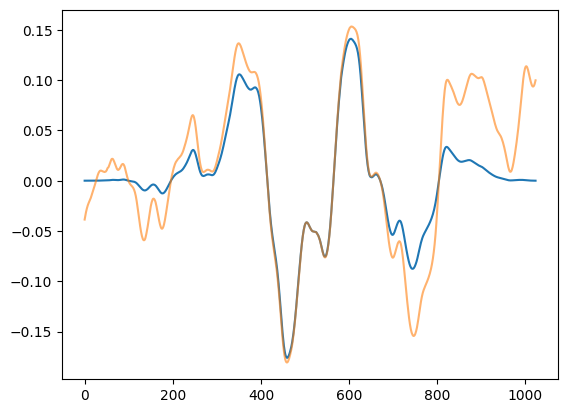

In [13]:
#Comparación del frame 1 con y sin suavizado
plt.plot(smoothed_frames[1],alpha=1); #frame 1 aplicando el suavizado.
plt.plot(sig_frames[1],alpha=0.6); #Es el frame 1 sin haber aplicado suavizado.

En la forma de onda de color azul se puede apreciar como se aplicó el suavizado dejando los laterales como si se hubiera aplicado una especie de fade in y fade out. Por otra parte en color naranjo se puede apreciar el frame 1 sin suavizado.

[-4.13266657e-03 -0.j          2.79437856e+00 -4.91750621j
 -5.57942274e+00 +0.54298809j ...  1.13657643e+01-16.54779894j
 -5.57942274e+00 -0.54298809j  2.79437856e+00 +4.91750621j]


C:\Users\danie\miniconda3\envs\acus099\lib\site-packages\matplotlib\cbook.py:1699: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\danie\miniconda3\envs\acus099\lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


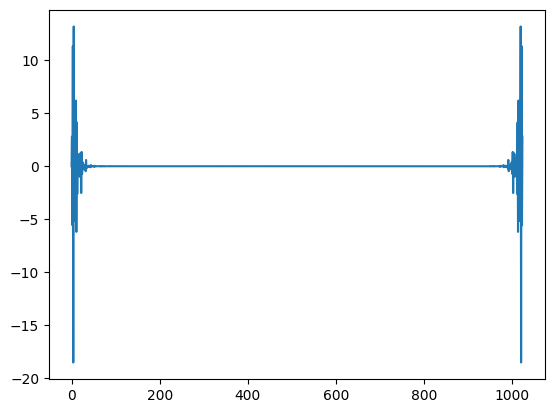

In [14]:
#En la siguiente línea se aplica la transformada de Fourier solamente al frame 1 de la señal suavizada.
sigfft=fft(smoothed_frames[1])
print(sigfft)
#Gráfica de la transformada de Fourier aplicada al frame 1 suavizado.
plt.plot(sigfft)

[4.13266657e-03 5.65600733e+00 5.60578221e+00 ... 2.00751151e+01
 5.60578221e+00 5.65600733e+00]


Text(0.5, 1.0, 'Magnitud de la transformada')

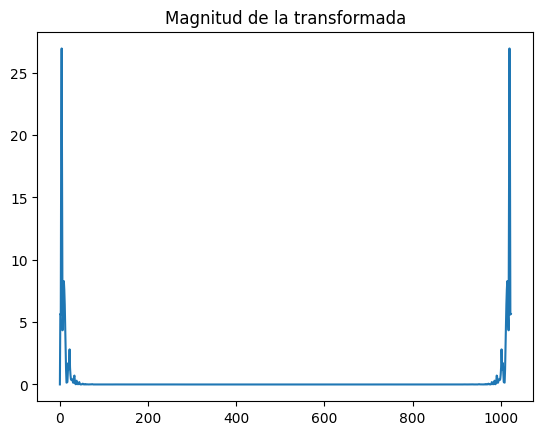

In [44]:
#Magnitud de la transformada
magsig_fft=np.abs(sigfft)
print(magsig_fft)
#Gráfica de la magnitud de la transformada del frame 1000
plt.plot(magsig_fft)
plt.title('Magnitud de la transformada')

Text(0.5, 1.0, 'Grafica de amplitud vs frecuencia del frame')

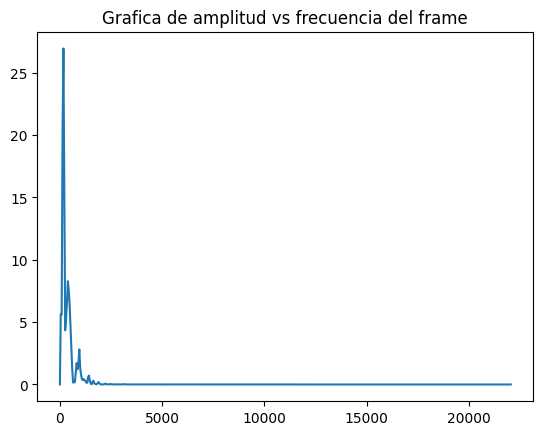

In [45]:
#Grafica de amplitud vs frecuencia del frame
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
plt.plot(b, magsig_fft[0:nfft//2]);
plt.title('Grafica de amplitud vs frecuencia del frame')

# Audio biófono

In [19]:
#Importamos un audio que contiene sonido de diversas aves
sig1,fs=lib.load("Aves.wav",sr=44100)
#La siguiente línea de código es para reproducir el Audio
Audio(sig1, rate=fs)

Text(0.5, 1.0, 'Audio de Aves')

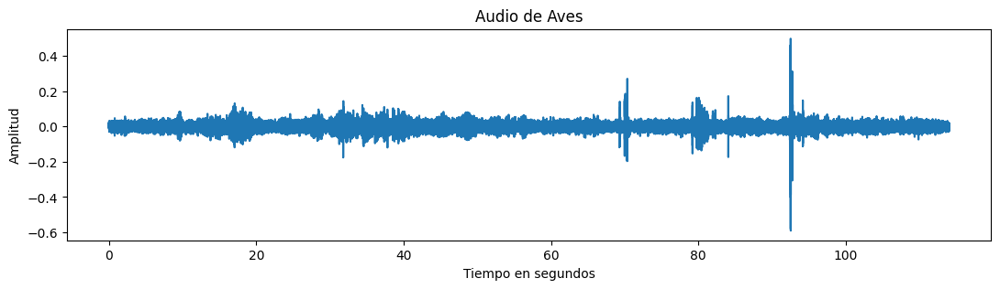

In [20]:
#Forma de onda temporal del audio biófono
t=np.linspace(0, len(sig1)/fs,len(sig1)) #tiempo en segundos

plt.figure(figsize=(13, 3))
plt.plot(t,sig1)
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Audio de Aves')

In [21]:
#Aplicamos la función de ventaneo para separar nuestra señal en diversos frames
sig1_frames=ventanas(sig1,len_f,overlap)

9823


In [22]:
#Creamos la matriz con los frames suavizados
smoothed_frames1 = np.empty_like(sig1_frames)

for i in range(sig1_frames.shape[0]):
    smoothed_frames1[i] = sig1_frames[i] * window

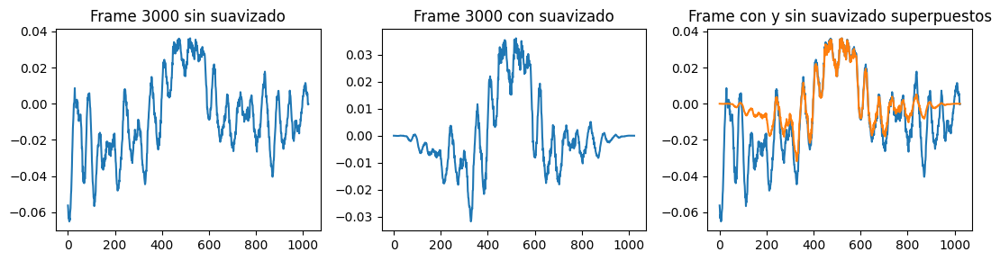

In [23]:
plt.figure(figsize=(11, 3))
a=3000 #frame
plt.subplot(1, 3, 1)
plt.plot(sig1_frames[a])
plt.title(f'Frame {a} sin suavizado')

plt.subplot(1, 3, 2)
plt.plot(smoothed_frames1[a])
plt.title(f'Frame {a} con suavizado')

plt.subplot(1, 3, 3)
plt.plot(sig1_frames[a])
plt.plot(smoothed_frames1[a])
plt.title(f'Frame con y sin suavizado superpuestos')

plt.tight_layout()
plt.show()


[0.7147953  4.18444929 5.89398207 ... 3.69263922 5.89398207 4.18444929]


Text(0.5, 1.0, 'Magnitud de la transformada')

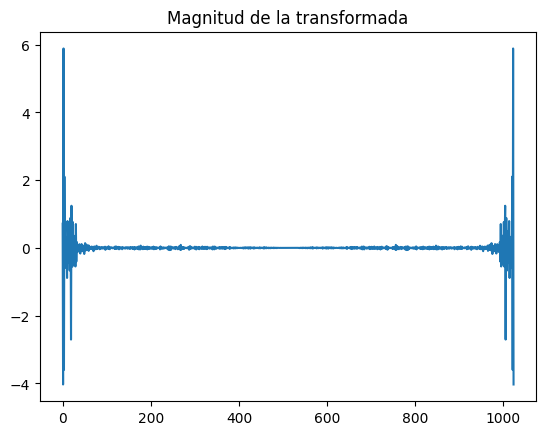

In [43]:
#Se aplica transformada de fourier al frame 3000 suavizado
sigfft1=fft(smoothed_frames1[3000])
#Magnitud de la transformada
magsig_fft1=np.abs(sigfft1)
print(magsig_fft1)
plt.plot(sigfft1)
plt.title('Magnitud de la transformada')

Text(0.5, 1.0, 'Grafica de amplitud vs frecuencia del frame')

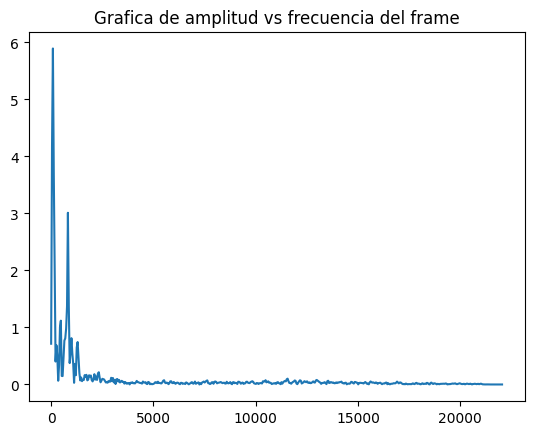

In [46]:
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
plt.plot(b, magsig_fft1[0:nfft//2]);
plt.title('Grafica de amplitud vs frecuencia del frame')

# Audio Antropófono

In [26]:
#Importamos un audio que contiene sonido de una protesta
sig2,fs=lib.load("Autos.wav",sr=44100)
#La siguiente línea de código es para reproducir el Audio
Audio(sig2, rate=fs)

Text(0.5, 1.0, 'Audio de Bocinas')

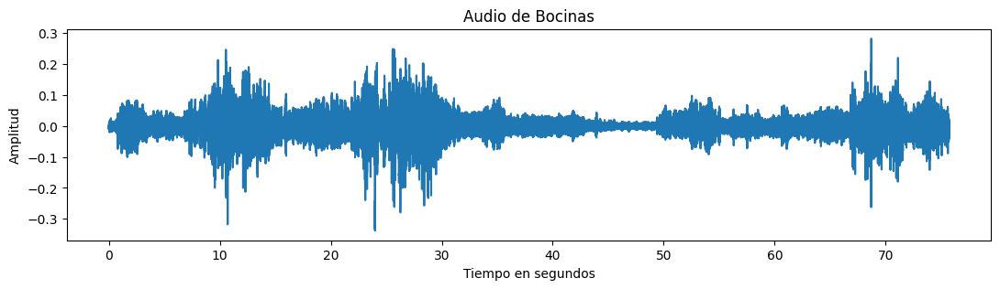

In [27]:
t = np.arange(len(sig2)) / fs 

plt.figure(figsize=(13, 3))
plt.plot(t,sig2)
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Audio de Bocinas')

In [28]:
#Aplicamos la función de ventaneo para separar nuestra señal en diversos frames.
sig2_frames=ventanas(sig2,len_f,overlap)

6523


In [29]:
#Creamos la matriz con los frames suavizados.
smoothed_frames2 = np.empty_like(sig2_frames)

for i in range(sig2_frames.shape[0]):
    smoothed_frames2[i] = sig2_frames[i] * window

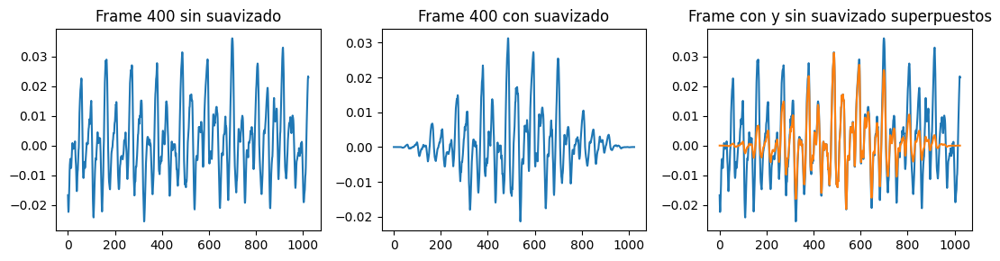

In [30]:
plt.figure(figsize=(11, 3))
b=400 #frame
plt.subplot(1, 3, 1)
plt.plot(sig2_frames[b])
plt.title(f'Frame {b} sin suavizado')

plt.subplot(1, 3, 2)
plt.plot(smoothed_frames2[b])
plt.title(f'Frame {b} con suavizado')

plt.subplot(1, 3, 3)
plt.plot(sig2_frames[b])
plt.plot(smoothed_frames2[b])
plt.title(f'Frame con y sin suavizado superpuestos')

plt.tight_layout()
plt.show()

[1.02075961 0.6965827  0.35914755 ... 0.35602771 0.35914755 0.6965827 ]


Text(0.5, 1.0, 'Magnitud de la transformada')

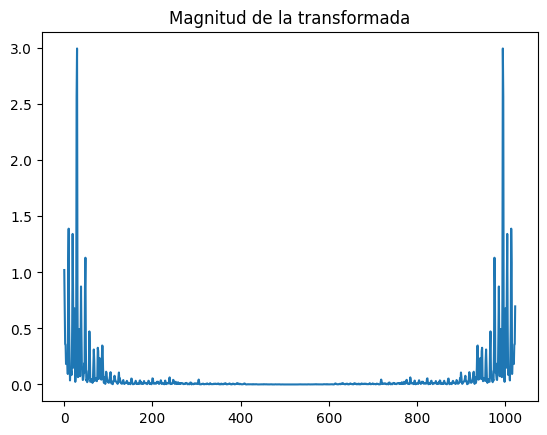

In [42]:
#Se aplica transformada de Fourier al frame 400 suavizado
sigfft2=fft(smoothed_frames2[400])
#Magnitud de la transformada
magsig_fft2=np.abs(sigfft2)
print(magsig_fft2)
plt.plot(magsig_fft2)
plt.title('Magnitud de la transformada')

Text(0.5, 1.0, 'Grafica de amplitud vs frecuencia del frame')

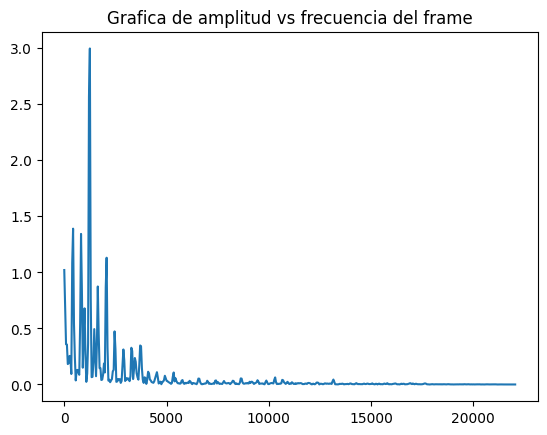

In [47]:
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
plt.plot(b, magsig_fft2[0:nfft//2]);
plt.title('Grafica de amplitud vs frecuencia del frame')

# Audio Geófono

In [33]:
#Importamos un audio que contiene sonidos de lluvia
sig3,fs=lib.load("Rain.wav",sr=44100)
#La siguiente línea de código es para reproducir el Audio
Audio(sig3, rate=fs)

Text(0.5, 1.0, 'Audio de lluvia ')

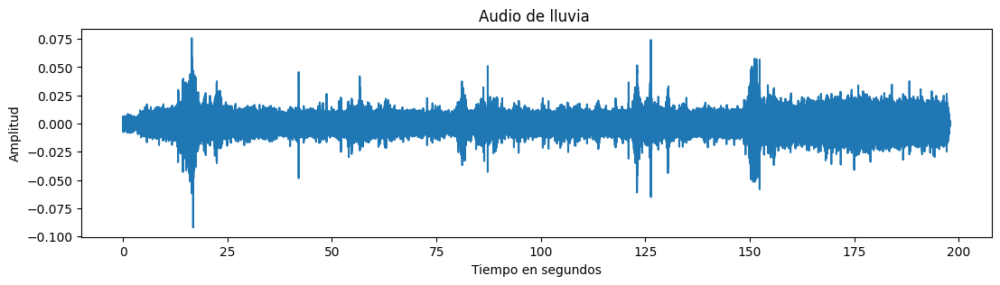

In [34]:
t = np.arange(len(sig3)) / fs 

plt.figure(figsize=(13, 3))
plt.plot(t,sig3)
plt.xlabel('Tiempo en segundos')
plt.ylabel('Amplitud')
plt.title('Audio de lluvia ')

In [35]:
#Separamos la señal en frames
sig3_frames=ventanas(sig3,len_f,overlap)

17054


In [36]:
#Creamos la matriz con los frames suavizados.
smoothed_frames3 = np.empty_like(sig3_frames)

for i in range(sig3_frames.shape[0]):
    smoothed_frames3[i] = sig3_frames[i] * window

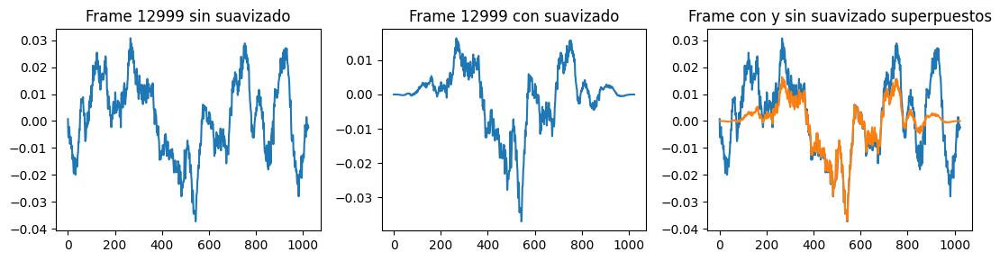

In [37]:
plt.figure(figsize=(11, 3))
c=12999 #frame
plt.subplot(1, 3, 1)
plt.plot(sig3_frames[c])
plt.title(f'Frame {c} sin suavizado')

plt.subplot(1, 3, 2)
plt.plot(smoothed_frames3[c])
plt.title(f'Frame {c} con suavizado')

plt.subplot(1, 3, 3)
plt.plot(sig3_frames[c])
plt.plot(smoothed_frames3[c])
plt.title(f'Frame con y sin suavizado superpuestos')

plt.tight_layout()
plt.show()

[0.94673932 2.80140454 4.01407114 ... 2.30788052 4.01407114 2.80140454]


Text(0.5, 1.0, 'Magnitud de la transformada')

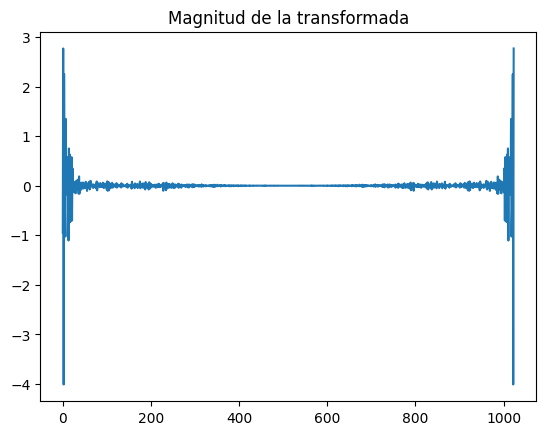

In [41]:
#Se aplica transformada de Fourier al frame 12999 suavizado
sigfft3=fft(smoothed_frames3[12999])
#Magnitud de la transformada
magsig_fft3=np.abs(sigfft3)
print(magsig_fft3)
plt.plot(sigfft3)
plt.title('Magnitud de la transformada')

Text(0.5, 1.0, 'Grafica de amplitud vs frecuencia del frame')

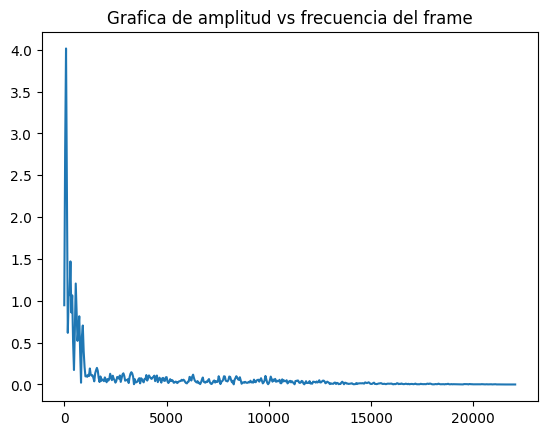

In [48]:
nfft=1024
b=np.linspace(0, 44100//2, nfft//2)
graf3 = plt.plot(b, magsig_fft3[0:nfft//2]);
plt.title('Grafica de amplitud vs frecuencia del frame')

# Comparación de gráficos

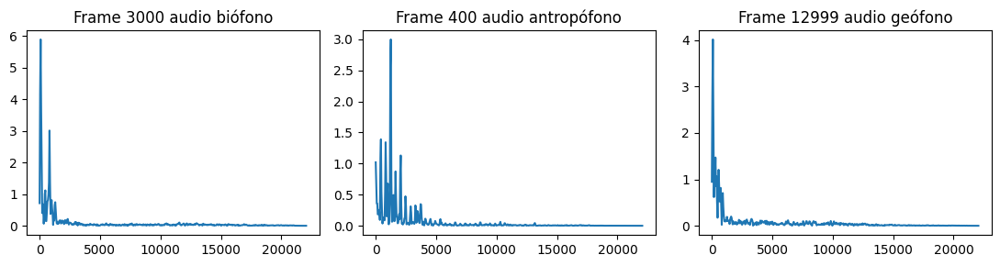

In [40]:
plt.figure(figsize=(11, 3))
c=12999 #frame
plt.subplot(1, 3, 1)
plt.plot(b, magsig_fft1[0:nfft//2])
plt.title('Frame 3000 audio biófono')

plt.subplot(1, 3, 2)
plt.plot(b, magsig_fft2[0:nfft//2])
plt.title('Frame 400 audio antropófono')

plt.subplot(1, 3, 3)
plt.plot(b, magsig_fft3[0:nfft//2])
plt.title('Frame 12999 audio geófono')

plt.tight_layout()
plt.show()

# Conclusión
Como se puede apreciar en los diversos frames de los distintos audios biófono, geófono y antropófono, tenemos que cada uno tiene comportamientos diferentes respecto a su contenido espectral, en el frame 400 del audio antropófono se ve cada frecuencia muy marcada, pudiendo distinguirse con claridad cada una, en el frame 12999 del audio geófono se puede apreciar como las frecuencias graves son las que mas resaltan y al aumentar la frecuencia la señal se vuelve ligeramente plana esto debido a que la señal analizada es de lluvia. Por otra parte tenemos el frame 3000 del audio biófonos que contiene variedad de tipo de aves, donde tambien se pueden apreciar ciertos picos de magnitud en ciertas frecuencias específicas.